In [1]:
import os
import sys
import argparse

import torch
from tqdm.notebook import tqdm

sys.path.append("../StyleCLIP_modular")
from style_clip import Imagine, create_text_path

In [6]:
parser = argparse.ArgumentParser()
parser.add_argument("--batch_size", default=32, type=int)
parser.add_argument("--gradient_accumulate_every", default=1, type=int)
parser.add_argument("--save_every", default=1, type=int)
parser.add_argument("--epochs", default=1, type=int)
parser.add_argument("--story_start_words", default=5, type=int)
parser.add_argument("--story_words_per_epoch", default=5, type=int)
parser.add_argument("--style", default="../stylegan2-ada-pytorch/VisionaryArt.pkl", type=str, choices=["faces (ffhq config-f)", "../stylegan2-ada-pytorch/VisionaryArt.pkl"])
parser.add_argument("--lr_schedule", default=0, type=int)
parser.add_argument("--start_image_steps", default=1000, type=int)
parser.add_argument("--iterations", default=100, type=int)
args = vars(parser.parse_args({}))

args["opt_all_layers"] = 1
args["lr_schedule"] = 1
args["noise_opt"] = 0
args["reg_noise"] = 0
args["seed"] = 1

args["model_type"] = "vqgan"
args["start_img_loss_weight"] = 0.0

args["lr"] = 0.1

In [505]:
import torchvision.transforms as T

color = 0.9

args["do_cutout"] = 0
# torchvision.transforms.RandomApply(transforms, p=0.5)
transform = T.Compose([
    T.RandomResizedCrop(224, scale=(0.1, 1.0)),#, ratio=(0.75, 1.3333333333333333)),
    T.ColorJitter(brightness=color, contrast=color, saturation=color, hue=color / 8),
    T.RandomAffine(10, translate=(0.01, 0.2), shear=None),
    #T.RandomPerspective(distortion_scale=0.25, p=0.5, fill=0),
    T.RandomErasing(p=0.5, scale=(0.02, 0.1), ratio=(0.3, 3.3), value=0),
])
test_transform = T.Compose([
    T.ToTensor(),
    transform,
    T.ToPILImage(),
])
#transform = None


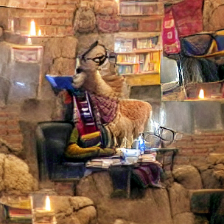

In [502]:
test_transform(pil_img)

In [506]:
args["sideX"] = 360
args["sideY"] = 360
args["iterations"] = 500
imagine = Imagine(
                text = "A lama wearing a scarf and glasses, reading a book in a cozy cafe.",#"A man painting a red painting",
                save_progress=False,
                open_folder=False,
                save_video=False,
                verbose=False,
                transform=transform,
                **args
               )
imagine()
latents = imagine.model.model.latents.detach().cpu()
model = imagine.model.model
model.latents = latents.to("cuda")
image = model(return_loss=False)
pil_img = T.ToPILImage()(image.squeeze(0).clamp(0, 1))
del imagine

setting seed: 1
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.


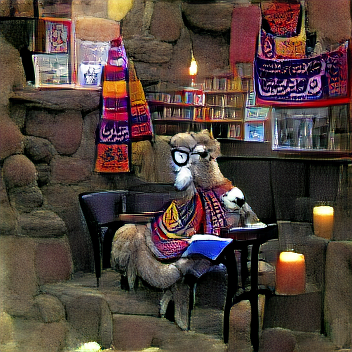

In [507]:
pil_img # full

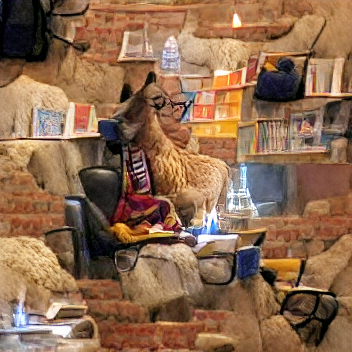

In [504]:
pil_img # resizeDefault

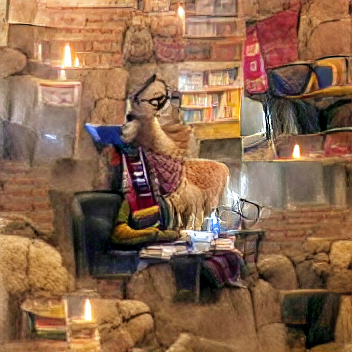

In [500]:
pil_img # resizeSquareRatio

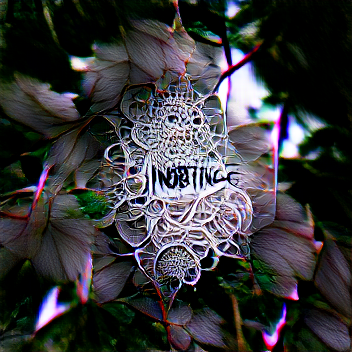

In [493]:
pil_img # resizeMin0.1 color0.9 rot10 500it hue/8 translate0.2 erase0.1 fractal

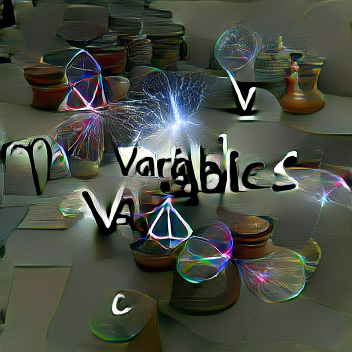

In [491]:
pil_img # resizeMin0.1 color0.9 rot10 500it hue/8 translate0.2 erase0.1 fractal

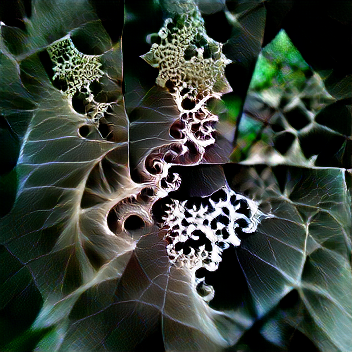

In [489]:
pil_img # resizeMin0.1 color0.9 rot10 500it hue/8 translate0.2 erase0.1 fractal

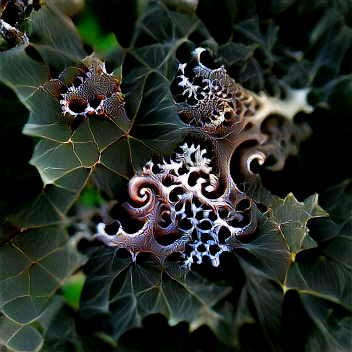

In [486]:
pil_img # resizeMin0.1 color0.9 rot180 500it hue/8 translate0.2 erase0.1 fractal

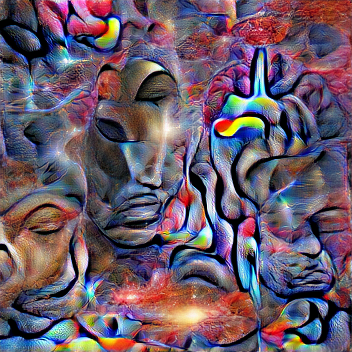

In [458]:
pil_img # default

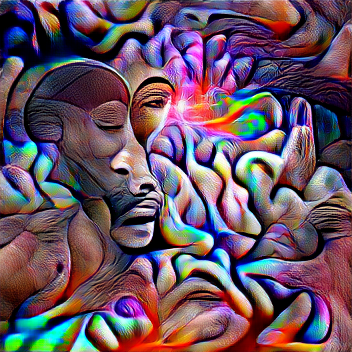

In [455]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1

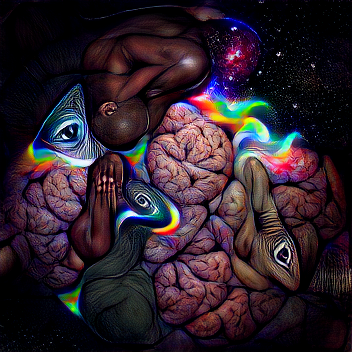

In [484]:
pil_img # resizeMin0.1 color0.9 rot180 500it hue/8 translate0.2 erase0.1

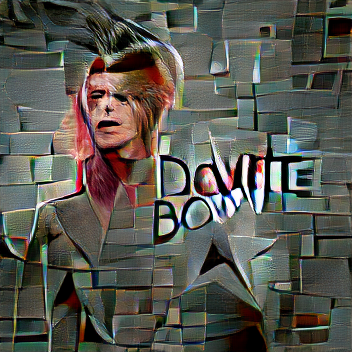

In [386]:
pil_img # resizeMin0.1 color0.9 rot10 200it hue/8 delete0 translate0.2

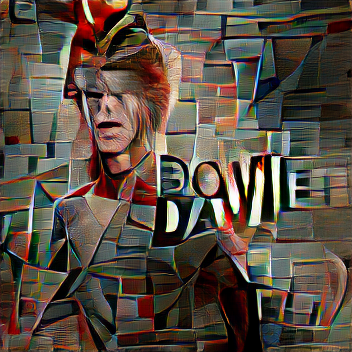

In [453]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1

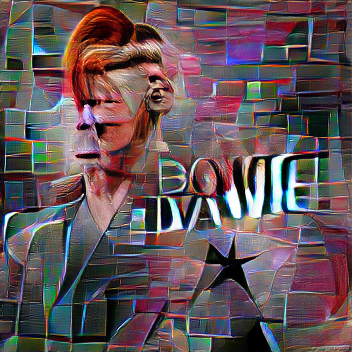

In [467]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1 horizontal

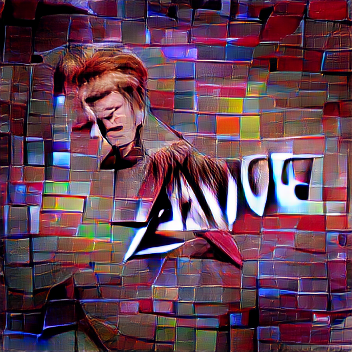

In [472]:
pil_img # resizeMin0.1 color0.9 rot360 100it hue/8 translate0.2 erase0.1

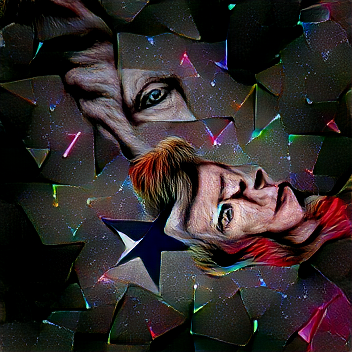

In [482]:
pil_img # resizeMin0.1 color0.9 rot180 500it hue/8 translate0.2 erase0.1

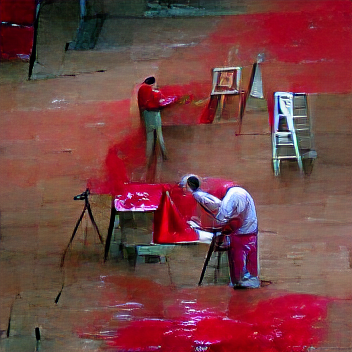

In [451]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1

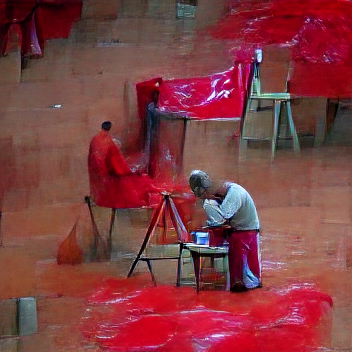

In [465]:
pil_img # resizeMin0.1 color0.9 rot10 200it hue/8 translate0.2 erase0.1 horizontal

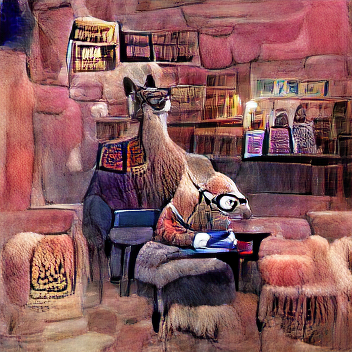

In [463]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1 horizontal

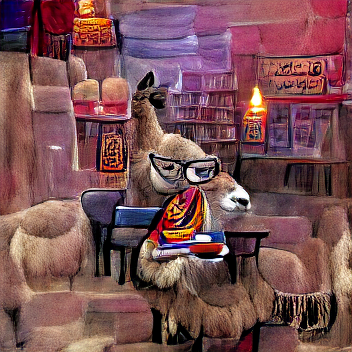

In [447]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1 shear0.2

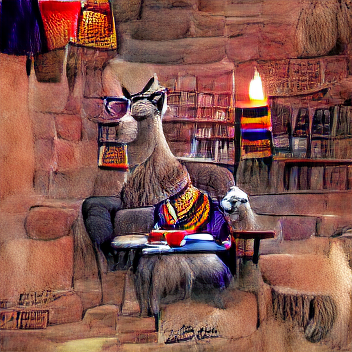

In [445]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1 shear0.2

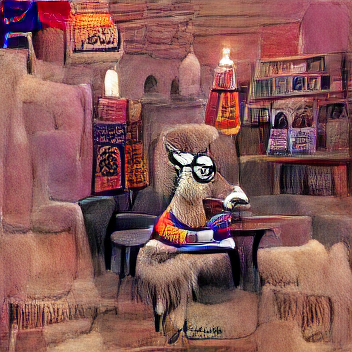

In [430]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2 erase0.1

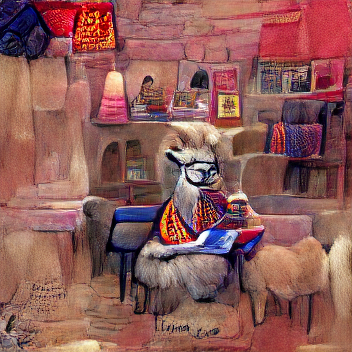

In [424]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 translate0.2

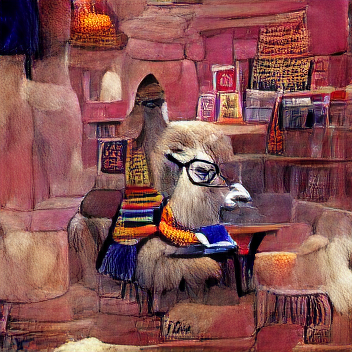

In [420]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 sat/2  translate0.2

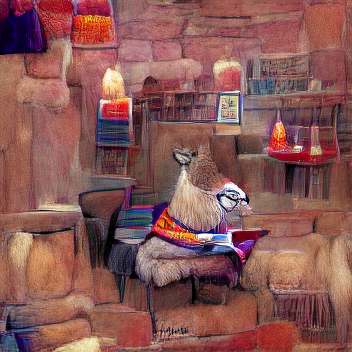

In [416]:
pil_img # resizeMin0.1 color0.9 rot10 100it hue/8 sat/2 bright/2 translate0.2

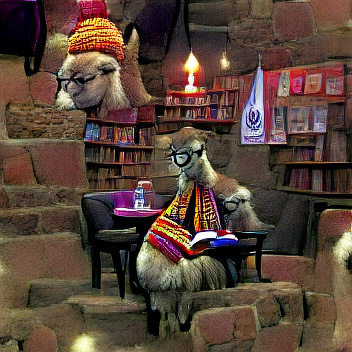

In [384]:
pil_img # resizeMin0.1 color0.9 rot10 500it hue/8 delete0 translate0.2

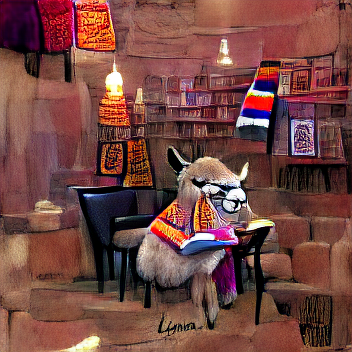

In [382]:
pil_img # resizeMin0.1 color0.9 rot10 200it hue/8 delete0 translate0.2

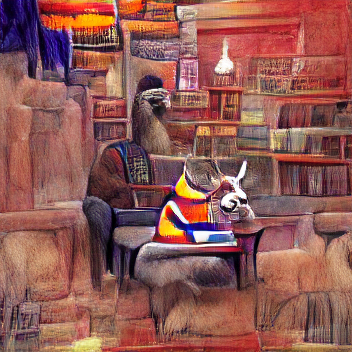

In [380]:
pil_img # resizeMin0.1 color0.9 rot10 50it hue/8 delete0 translate0.2

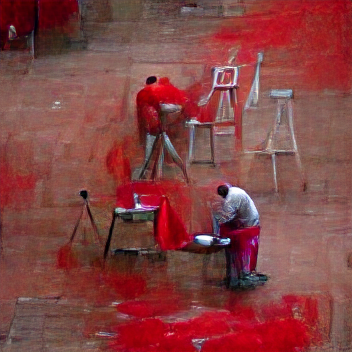

In [378]:
pil_img # resizeMin0.1 color0.9 rot10 50it hue/8 delete0 translate0.2

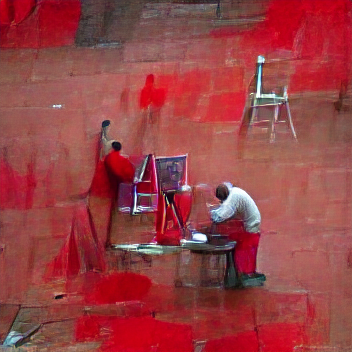

In [373]:
pil_img # resizeMin0.1 color0.9 rot10 50it hue/8 delete0

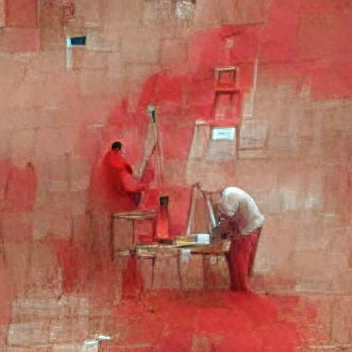

In [369]:
pil_img # resizeMin0.1 rot5

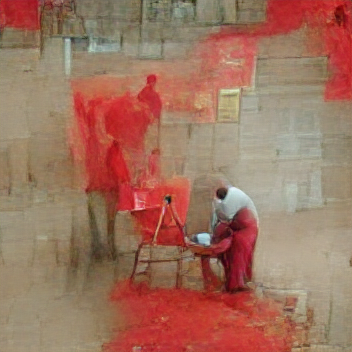

In [365]:
pil_img # resizeMin0.1 rot20

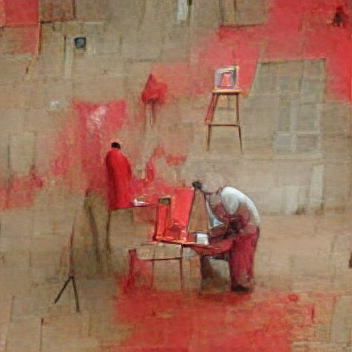

In [361]:
pil_img # resizeMin0.1 rot10

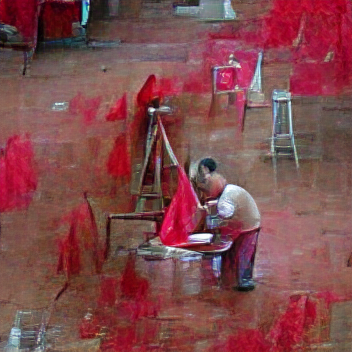

In [357]:
pil_img # resizeMin0.1 color0.9 rot10 50it hue/8

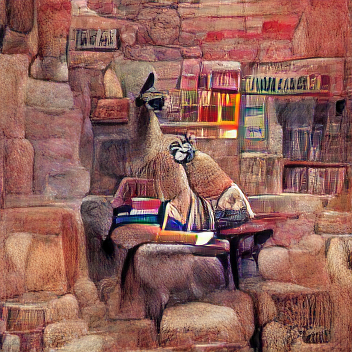

In [355]:
pil_img # resizeMin0.1 color0.9 rot10 50it hue/8

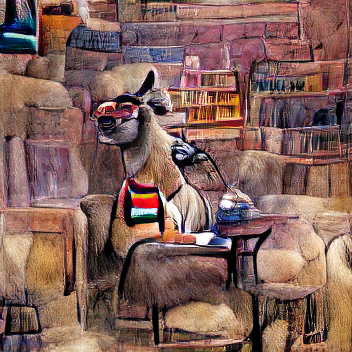

In [312]:
pil_img # resizeMin0.1 color0.99 rot10 50it hue/16

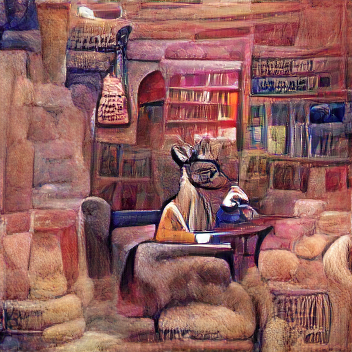

In [305]:
pil_img # resizeMin0.1 color0.99 rot10 50it hue/8

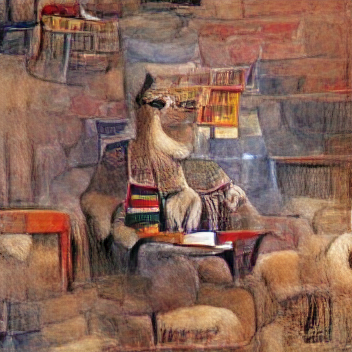

In [301]:
pil_img # resizeMin0.1 color0.25 rot10 50it hue/8

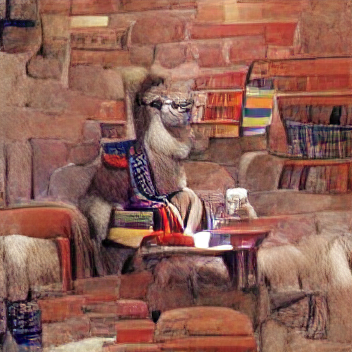

In [297]:
pil_img # resizeMin0.1 color0.25 rot10 50it randomerase0

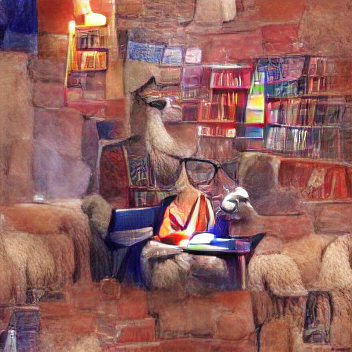

In [294]:
pil_img # resizeMin0.1 color0.25 rot10 50it randomeraseRandom

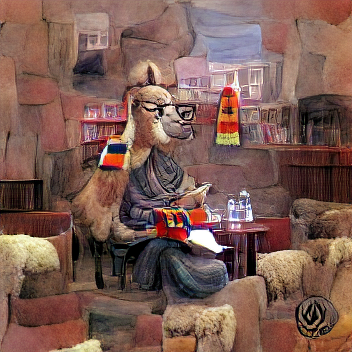

In [243]:
pil_img # resizeMin0.1 color0.25 rot10 500it

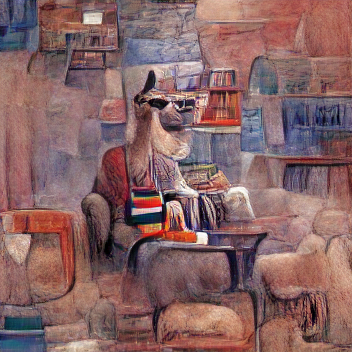

In [241]:
pil_img # resizeMin0.1 color0.25 rot10

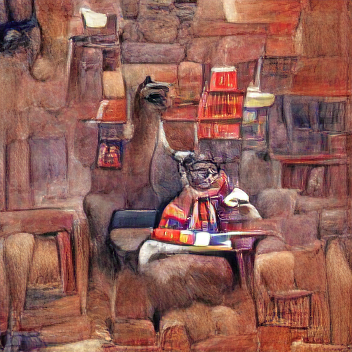

In [237]:
pil_img # resizeMin0.01 color0.25 rot10

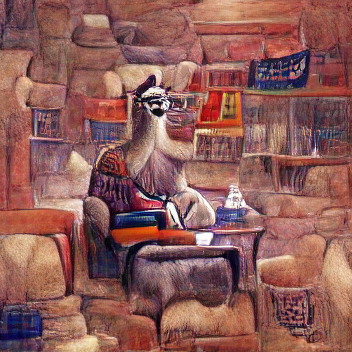

In [233]:
pil_img # resizeMin0.01 color0.25 rot10 distor0.25p0.5

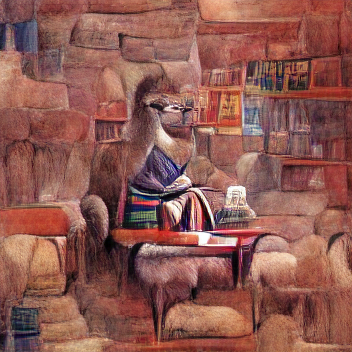

In [194]:
pil_img # resize color0.25 rot10 distor0.25p0.5

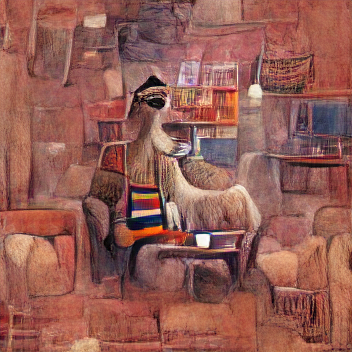

In [191]:
pil_img # resize color0.25 rot10 50it

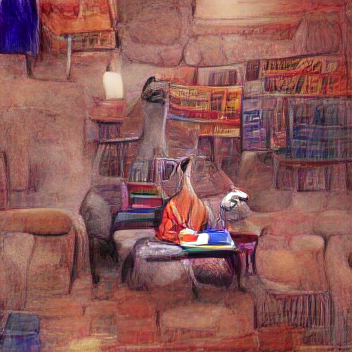

In [188]:
pil_img # resize color0.25 rot30 50it

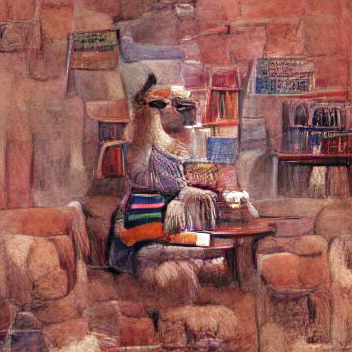

In [176]:
pil_img # resize color0.25 rot5 50it

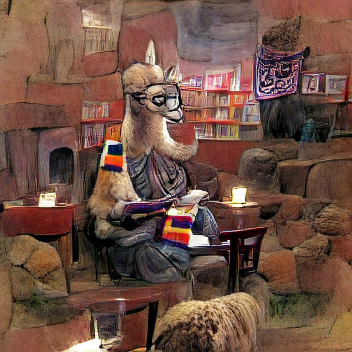

In [173]:
pil_img # resize color0.25 rot10 500it

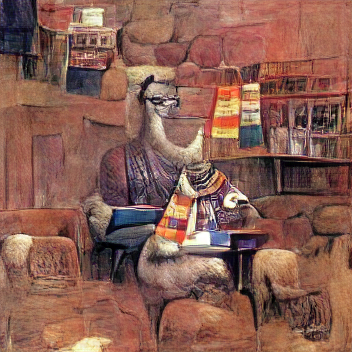

In [168]:
pil_img # resize color0.25 rot10 horizontal

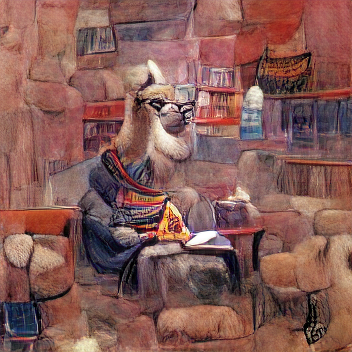

In [165]:
pil_img # resize color0.25 rot10

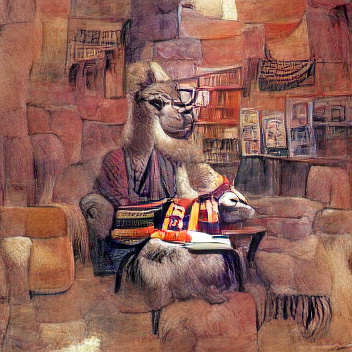

In [162]:
pil_img # resize grayscale0.1 color0.25 rot10

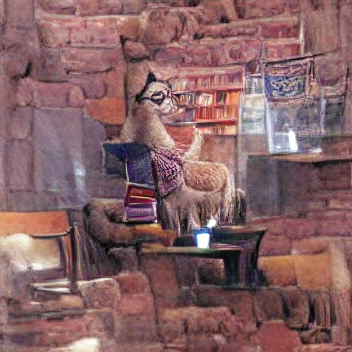

In [159]:
pil_img # resize grayscale0.1 color0.25

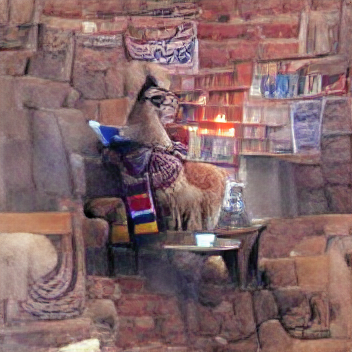

In [156]:
pil_img # resize color0.15

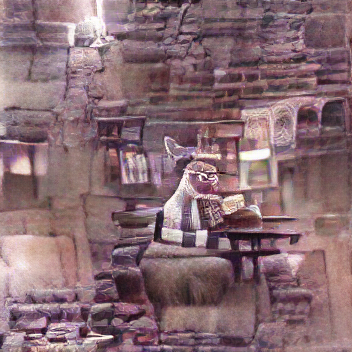

In [150]:
pil_img # resize grayscale0.99

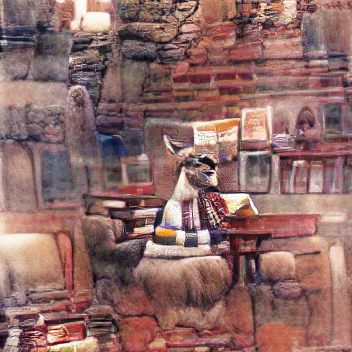

In [147]:
pil_img # resize grayscale0.7

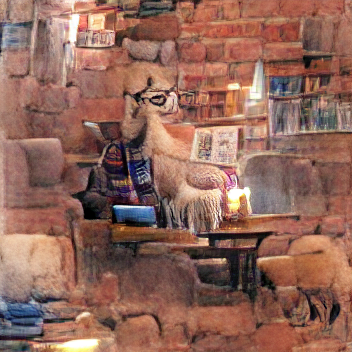

In [144]:
pil_img # resize grayscale0.4

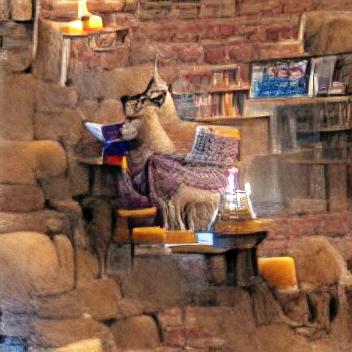

In [141]:
pil_img # resize grayscale0.1

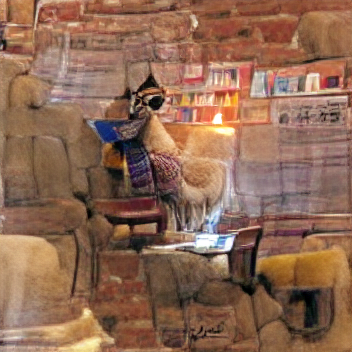

In [153]:
pil_img # resize grayscale0.0

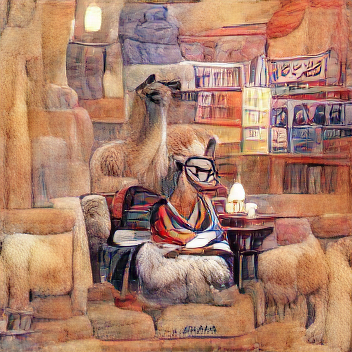

In [138]:
pil_img # resize rot10 jitter0.15 grayscale0.5

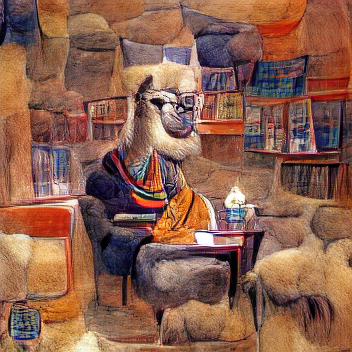

In [135]:
pil_img # resize rot10 jitter0.15 perspective

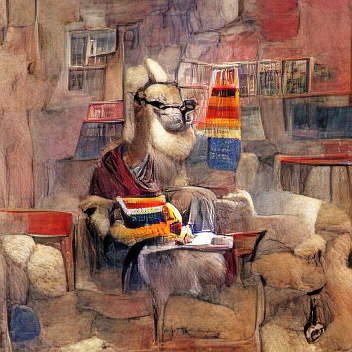

In [132]:
pil_img # resize rot10 jitter0.15

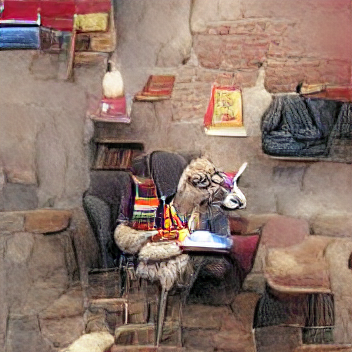

In [129]:
pil_img # resize rot45 jitter0.15

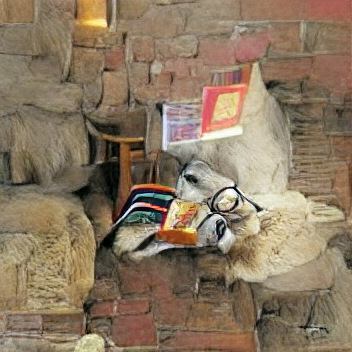

In [126]:
pil_img # resize rot180 jitter0.15

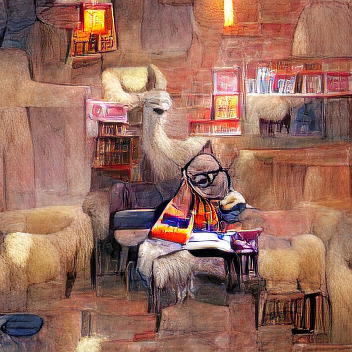

In [123]:
pil_img # resize rot30 jitter0.15

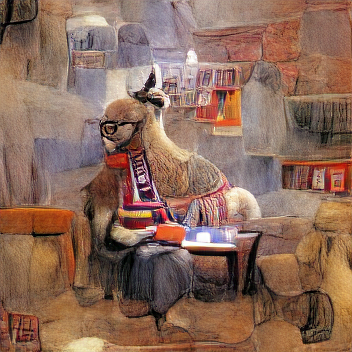

In [120]:
#resize horizontal rot15 jitter0.15

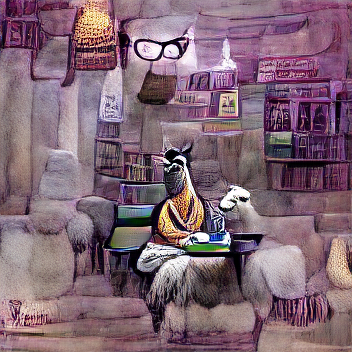

In [114]:
# resize jitter0.99 horizontal rot15

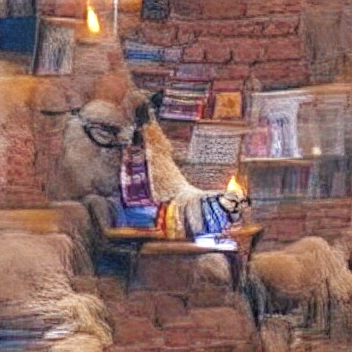

In [111]:
#resize blurkernel25min0.01

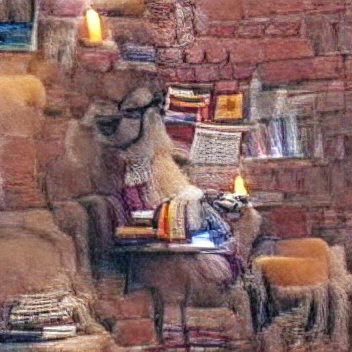

In [108]:
# resize blurkernel5min0.01

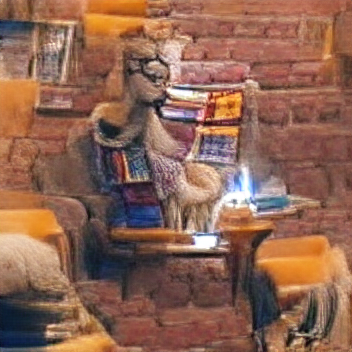

In [104]:
#resize blur

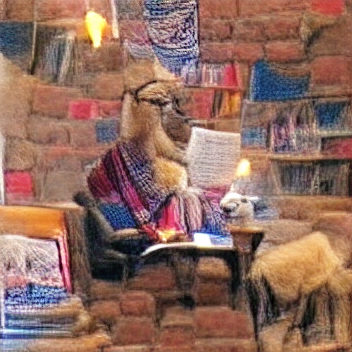

In [99]:
#resize perspective blur

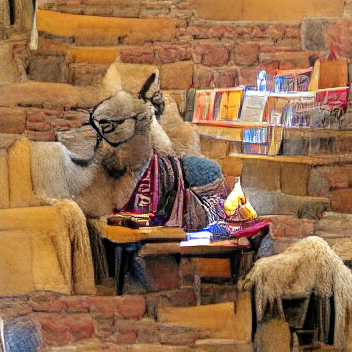

In [96]:
#resize perspective erase

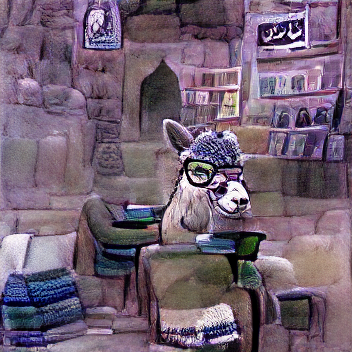

In [93]:
#resize color0.99

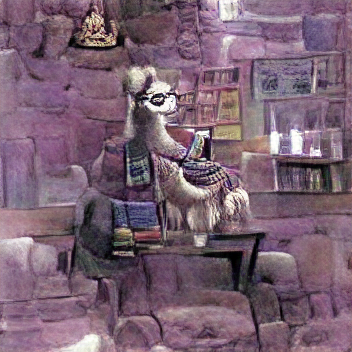

In [90]:
#resize color0.6

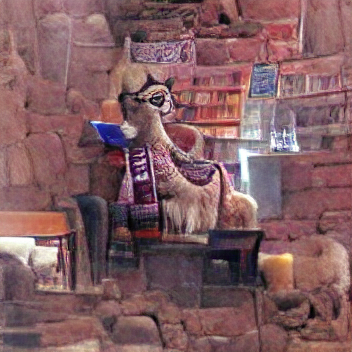

In [87]:
#resize color0.3

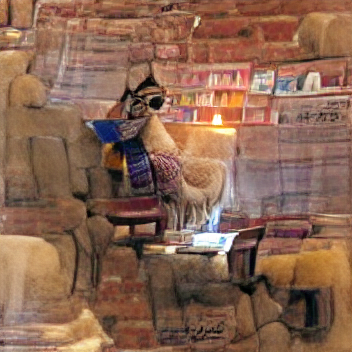

In [84]:
#resize0.08

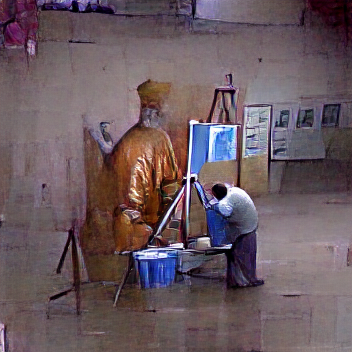

In [79]:
#resize jitter0.99 horizontal0.5 rot15

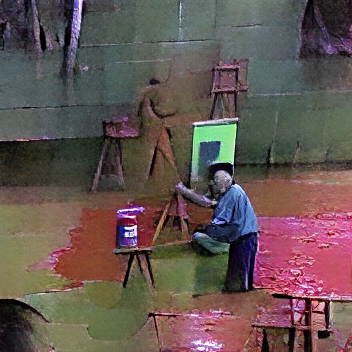

In [76]:
#resize jitter0.99 300it

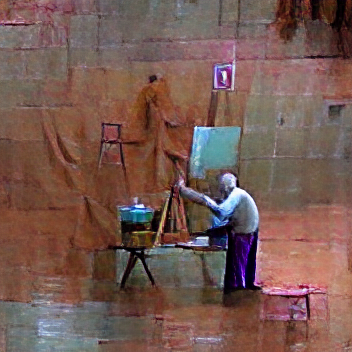

In [74]:
# resize jitter0.99

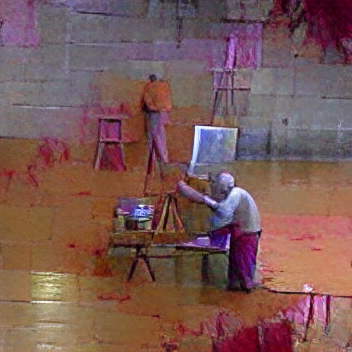

In [71]:
#resize jitter0.8

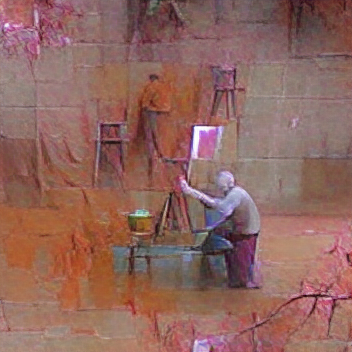

In [66]:
#resize jitter0.5

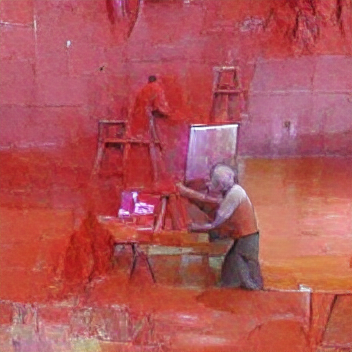

In [63]:
# resize jitter0.2

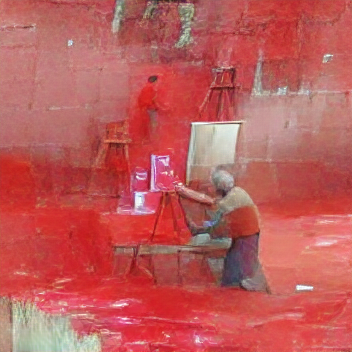

In [60]:
# resize0.08 jitter0.1

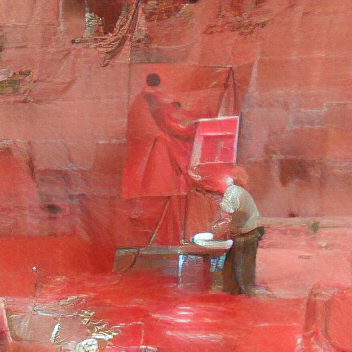

In [57]:
# resize0.5

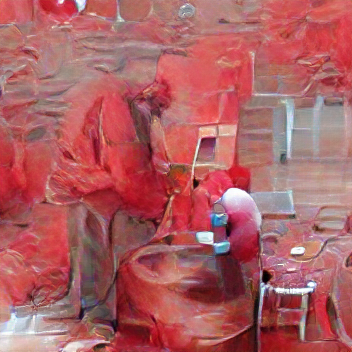

In [54]:
# random perspective 300it

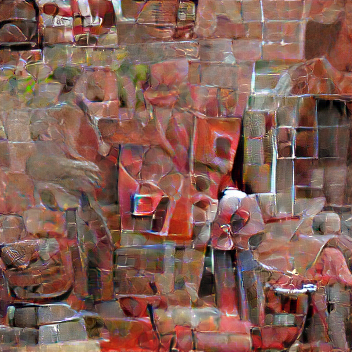

In [51]:
#randomerase for 300it

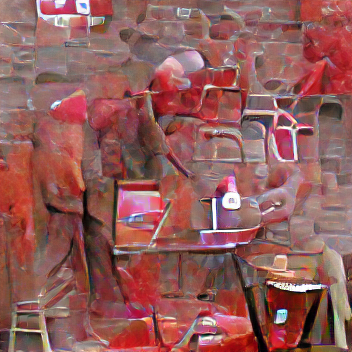

In [48]:
horizontal, colorjitter, gaussblur, randomerase

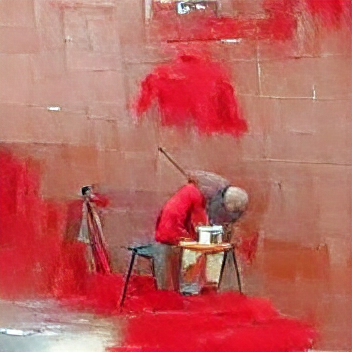

In [45]:
horizontal, colorjitter, resize, gaussblur, randomerase

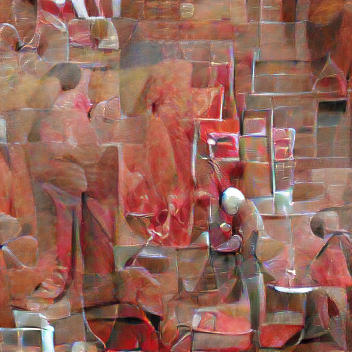

In [42]:
# random erase default

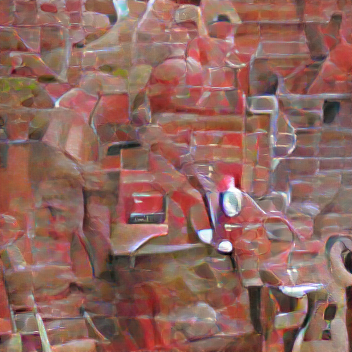

In [38]:
gauss blur default

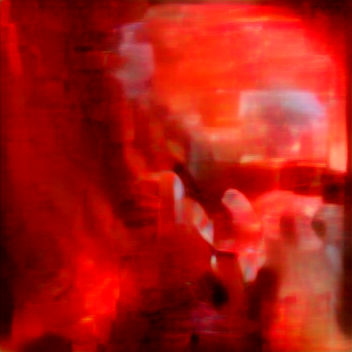

In [35]:
#random affine with all 0.2

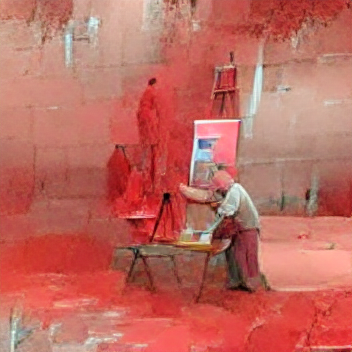

In [30]:
only resized random crop

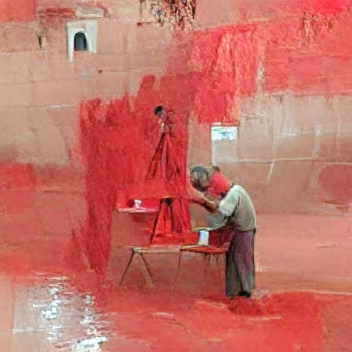

In [27]:
resize, flip, rotate

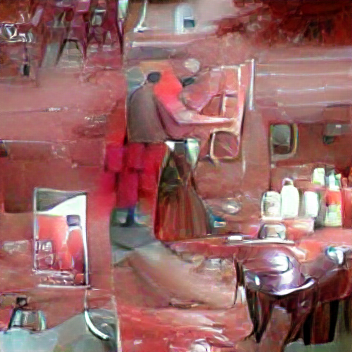

In [22]:
pil_img

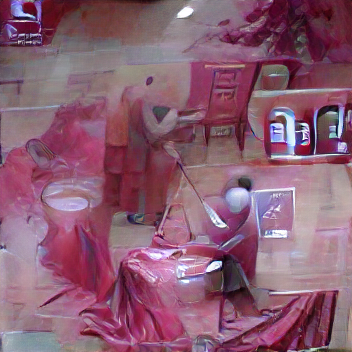

In [19]:
pil_img

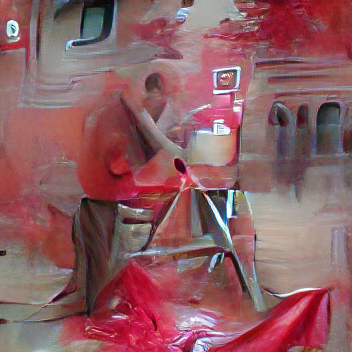

In [17]:
pil_img

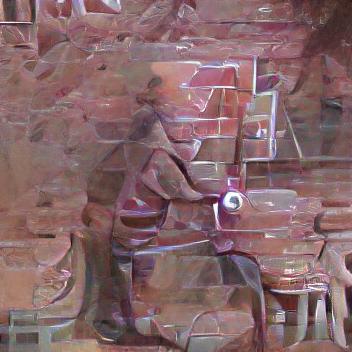

In [12]:
pil_img

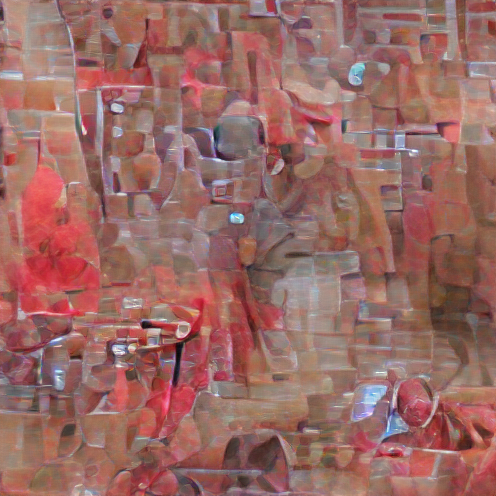

In [5]:
pil_img

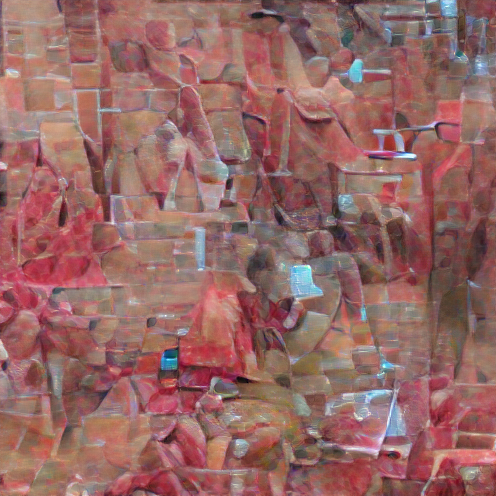

In [5]:
pil_img